In [1]:
%matplotlib inline
import librosa
import librosa.display
import numpy as np
import IPython.display as ipd
import matplotlib.pyplot as plt
import mirdata
import jams
import crema

Using TensorFlow backend.
/scratch/qx244/envs/crema/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/scratch/qx244/envs/crema/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/scratch/qx244/envs/crema/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/scratch/qx244/envs/crema/lib/python3.6/site-pa

In [2]:
beatles = mirdata.initialize('beatles', data_home='/scratch/qx244/data/Beatles')

In [3]:
test_track = beatles.track('0908')

In [4]:
test_track.title, test_track.audio_path

('08_-_Strawberry_Fields_Forever',
 '/scratch/qx244/data/Beatles/audio/09_-_Magical_Mystery_Tour/08_-_Strawberry_Fields_Forever.wav')

In [5]:
test_jams = test_track.to_jams()
test_jams

,time,duration,value,confidence
0,0.408,0.000,1,None
1,1.045,0.000,2,None
2,1.731,0.000,3,None
3,2.433,0.000,4,None
4,3.118,0.000,1,None
5,3.771,0.000,2,None
6,4.490,0.000,3,None
7,5.201,0.000,4,None
8,5.872,0.000,1,None
9,6.602,0.000,2,None


In [6]:
y, sr = test_track.audio
ipd.Audio(data=y, rate=sr)

In [7]:
chord_model = crema.models.chord.ChordModel()
output = chord_model.outputs(filename=test_track.audio_path)
pred_anno = chord_model.predict(filename=test_track.audio_path)
c_pump = chord_model.pump['chord_struct']

In [10]:
output.keys()

dict_keys(['chord_tag', 'chord_pitch', 'chord_root', 'chord_bass'])

In [11]:
chord_model.pump

In [9]:
pumpped_anno = c_pump.transform_annotation(pred_anno, pred_anno.duration)

In [11]:
target_dist = c_pump.transform(test_jams)
target_dist.keys()

dict_keys(['chord_struct/bass', 'chord_struct/_valid', 'chord_struct/root', 'chord_struct/pitch'])

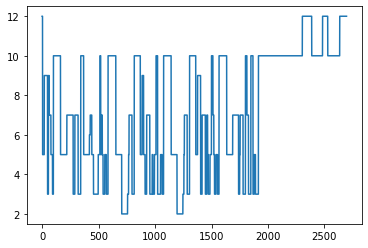

In [12]:
plt.plot(np.squeeze(target_dist['chord_struct/root']))

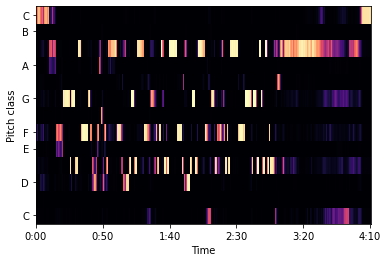

In [13]:
librosa.display.specshow(output['chord_root'].T, 
                         sr=c_pump.sr, 
                         hop_length=c_pump.hop_length, 
                         x_axis='time', 
                         y_axis='chroma')

In [40]:
def frame_nll(beta, target, raw):
    """
    Parameters:
        beta: float in [0,1], inverse temprature alla calibration
        target: target class represented as an int (index) in [0, len(raw))
        raw: a quasi-distribution vector, ie sum(raw) = 1
    Returns:
        negative log likelihood of the raw distribution after calibration by beta, against the target 
    """
    z_vec = np.log(raw)
    logsumexp = np.log(np.sum(np.exp(beta*z_vec))) # find a more stable version
    return -beta*z_vec[target] + logsumexp

In [31]:
t = 4
raw = output['chord_root'][t,:]
target = np.squeeze(target_dist['chord_struct/root'])[t]

In [55]:
def track_nll(beta, hard_label, soft_out):
    """ just summing frame_nll across the whole track
    Param:
        beta: inverse temp in [0,1]
        hard_label: vector of labels, index style
        soft_out: matrix with shape: len(hard_label) x # of classes
    Returns:
        Aggregated frame_nll
    """
    num_frames = len(hard_label)
    frame_nll_vec = [frame_nll(beta, hard_label[t], soft_out[t,:]) for t in np.arange(num_frames)]
    return np.sum(frame_nll_vec)/num_frames

In [14]:
def better_track_nll(beta, hard_label, soft_out):
    """ just summing frame_nll across the whole track
    Param:
        beta: inverse temp in [0,1]
        hard_label: vector of labels, index style
        soft_out: matrix with shape: len(hard_label) x # of classes
    Returns:
        Aggregated frame_nll
    """
    z_mat = np.log(soft_out) # time x classes
    logsumexp_vec = np.log(np.sum(np.exp(beta*z_mat), axis=-1, keepdims=True)) # find a more stable version, shape = t
    per_frame_nll = -beta*np.take_along_axis(z_mat, hard_label[:,np.newaxis], axis=1) + logsumexp_vec
    return np.mean(per_frame_nll)

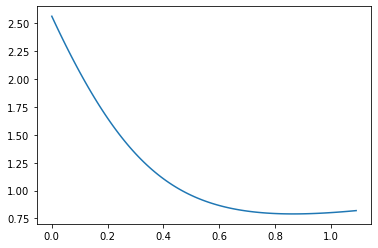

In [16]:
plt.plot(np.arange(0,1.1,0.01), 
         [better_track_nll(b, np.squeeze(target_dist['chord_struct/root']), output['chord_root']) 
          for b in np.arange(0,1.1,0.01)])

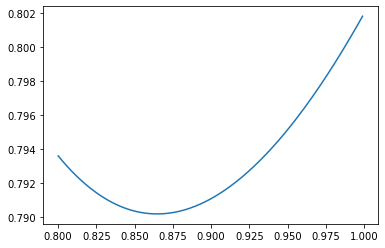

In [17]:
plt.plot(np.arange(0.8,1,0.001),
         [better_track_nll(b, np.squeeze(target_dist['chord_struct/root']), output['chord_root']) 
          for b in np.arange(0.8,1,0.001)])

In [18]:
from scipy.optimize import minimize_scalar

In [19]:
res = minimize_scalar(better_track_nll, 
                      args=(np.squeeze(target_dist['chord_struct/root']), output['chord_root']),
                      bounds=(0, 1),
                      method='bounded')

In [20]:
res

     fun: 0.7901913
 message: 'Solution found.'
    nfev: 21
  status: 0
 success: True
       x: 0.8645775735128706

In [195]:
def calibrate(beta, raw_conf):
    """ Calibrate the raw output with parameter beta
    params:
        beta: inverse temprature
        raw_conf: np.array of uncalibrated confidence, shape: # of entries x # of classes
    returns:
        calibrated_conf: same shape as raw_out, but calibrated
    """
    entry_count, class_count = raw_conf.shape
    calibrated_conf = np.empty(raw_conf.shape)
    for i in range(entry_count):
        unnormalized = raw_conf[i, :] ** beta
        calibrated_conf[i, :] = unnormalized / np.sum(unnormalized)
    return calibrated_conf

In [15]:
def better_calibrate(beta, raw_conf):
    """ Calibrate the raw output with parameter beta
    params:
        beta: inverse temprature
        raw_conf: np.array of uncalibrated confidence, shape: # of entries x # of classes
    returns:
        calibrated_conf: same shape as raw_out, but calibrated
    """
    entry_count, class_count = raw_conf.shape
    calibrated_conf = np.empty(raw_conf.shape)
    unnormalized = raw_conf ** beta
    return unnormalized / np.sum(unnormalized, axis=1, keepdims=True)

In [197]:
test_mat / np.sum(test_mat, axis=1, keepdims=True)

array([[0.16666667, 0.33333333, 0.5       ],
       [0.26666667, 0.33333333, 0.4       ]])

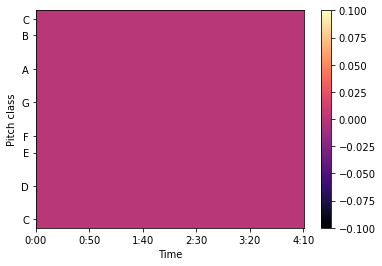

In [198]:
calibrated_conf = calibrate(res.x, output['chord_root'])
another_calibrated_conf = better_calibrate(res.x, output['chord_root'])

librosa.display.specshow(calibrated_conf.T - another_calibrated_conf.T, 
                         sr=c_pump.sr, 
                         hop_length=c_pump.hop_length, 
                         x_axis='time', 
                         y_axis='chroma')
plt.colorbar()

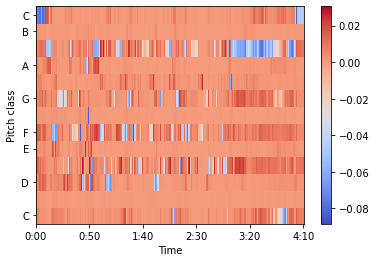

In [22]:
calibrated_conf = better_calibrate(res.x, output['chord_root'])

librosa.display.specshow(calibrated_conf.T - output['chord_root'].T, 
                         sr=c_pump.sr, 
                         hop_length=c_pump.hop_length, 
                         x_axis='time', 
                         y_axis='chroma')
plt.colorbar()

## Reliability Diagram and Expected Calibration Error (ECE)

In [23]:
def create_bins(data, m=15):
    """ Bin the samples according to their confidence
    Params:
        data: np.array with shape: (#entries, #classes)
        m: int > 1; number of bins; default is 15 bins
    Returns:
        binned_index: a list of lists: len(binned_index) = m, and each of these m lists contain the indicies of 
        the original dataset that has their output confidence in the range of the associated bin. 
    """
    # create empty list of lists
    binned_index = [[] for _ in range(m)]
    entry_count, class_count = data.shape
    
    # get the confidence of the predicted class
    conf = data.max(axis=1)
    # strategy: expand(multiply) the conf vector by a factor of m, then use flooring
    tentative_bins = np.floor(conf * m).astype(int)
    for i in range(entry_count):
        if tentative_bins[i] != m:
            binned_index[tentative_bins[i]].append(i)
        else: # when confidence is exactly 1, put in the last bin
            binned_index[m-1].append(i)
    return binned_index
        

In [24]:
output['chord_root'].shape

(2697, 13)

In [25]:
binned_index_raw = create_bins(output['chord_root'], m=20)
[len(binned_index_raw[i]) for i in range(len(binned_index_raw))]

[0,
 0,
 0,
 0,
 8,
 16,
 58,
 58,
 59,
 103,
 110,
 112,
 160,
 121,
 136,
 155,
 164,
 248,
 357,
 832]

In [26]:
binned_index_calib = create_bins(calibrated_conf, m=20)
[len(binned_index_calib[i]) for i in range(len(binned_index_calib))]

[0,
 0,
 0,
 0,
 11,
 42,
 64,
 64,
 94,
 131,
 134,
 164,
 124,
 162,
 146,
 177,
 199,
 252,
 413,
 520]

### Nextup: creating average accuracy and average confidence within each bin

In [107]:
class CalibrationBenchmark(object):
    
    def __init__(self, data, label, m=15):
        self.data = data
        self.label = label
        self.m = m
        
        self.binned_index = []
        self.conf = []
        self.pred = []
        
        self.create_bins()
        
    def create_bins(self):
        """ Bin the samples according to their confidence
        Params:
            data: np.array with shape: (#entries, #classes)
            m: int > 1; number of bins; default is 15 bins
        Returns:
            binned_index: a list of lists: len(binned_index) = m, and each of these m lists contain the indicies of 
            the original dataset that has their output confidence in the range of the associated bin. 
        """
        # create empty list of lists
        binned_index = [[] for _ in range(self.m)]
        entry_count, class_count = self.data.shape

        # get the confidence of the predicted class
        self.conf = self.data.max(axis=1)
        self.pred = self.data.argmax(axis=1)
        # strategy: expand(multiply) the conf vector by a factor of m, then use flooring
        tentative_bins = np.floor(self.conf * self.m).astype(int)
        for i in range(entry_count):
            if tentative_bins[i] != self.m:
                binned_index[tentative_bins[i]].append(i)
            else: # when confidence is exactly 1, put in the last bin
                binned_index[self.m-1].append(i)
        self.binned_index = binned_index
        
    def hist(self):
        return np.array([len(self.binned_index[i]) for i in range(len(self.binned_index))])
    
    def bin_accuracy(self):
        result = np.empty((self.m,))
        
        for i in range(self.m):
            if len(self.binned_index[i]) == 0:
                result[i] = 0
            else:
                result[i] = np.mean(self.pred[self.binned_index[i]] == self.label[self.binned_index[i]])
        return result
    
    def bin_confidence(self):
        result = np.empty((self.m,))
            
        for i in range(self.m):
            if len(self.binned_index[i]) == 0:
                result[i] = 0
            else:
                result[i] = np.mean(self.conf[self.binned_index[i]])
        return result
    
    def ece(self):
        error = self.bin_accuracy() - self.bin_confidence()
        weight = self.hist() / self.data.shape[0]
        return np.dot(np.abs(error), weight)    

In [108]:
test = CalibrationBenchmark(output['chord_root'], np.squeeze(target_dist['chord_struct/root']), m=20)

In [109]:
test_calib = CalibrationBenchmark(calibrated_conf, np.squeeze(target_dist['chord_struct/root']), m=20)

In [110]:
a=test.bin_accuracy()
b=test.bin_confidence()

In [111]:
a_calib=test_calib.bin_accuracy()
b_calib=test_calib.bin_confidence()

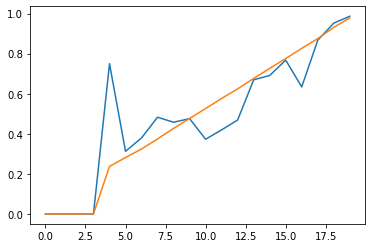

In [112]:
plt.plot(a)
plt.plot(b)
plt.show()

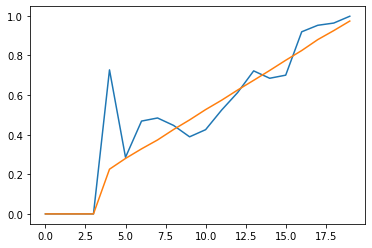

In [113]:
plt.plot(a_calib)
plt.plot(b_calib)
plt.show()

In [119]:
x, y = test.ece()

In [122]:
p, q = test_calib.ece()

In [121]:
np.dot(x, y)

0.04822875043839314

In [123]:
np.dot(p,q)

0.055785775554812206

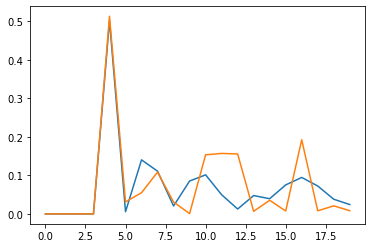

In [124]:
plt.plot(p)
plt.plot(x)
plt.show()